# Installations

In [ ]:
# !pip install soundfile
# !pip install torchaudio

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


# Parameters


In [ ]:
working_sr = 16000

In [ ]:
import os
import soundfile as sf
import librosa
import numpy as np
import IPython.display as ipd
import torchaudio
import torch
import torch.nn as nn
from tqdm import tqdm

In [ ]:
# original_songs_sr = 44100
# resampler = torchaudio.transforms.Resample(orig_freq=original_songs_sr, new_freq=working_sr)

# Load Data

In [ ]:
base_path = '/content/drive/MyDrive/Ofir/SoundProcessingFinalProject'
data_path = os.path.join(base_path, 'Data')
dataset_path = os.path.join(data_path, 'dataset_organized')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Load Audio Songs- no need, processed saved in drive

In [ ]:
# songs_path = os.path.join(data_path, 'songs')
# accompaniment_path = os.path.join(data_path, 'songs/accompaniment')
# vocal_path = os.path.join(data_path, 'songs/vocal')

In [ ]:
# songs_pairs = []
# for filename in os.listdir(accompaniment_path):
#     if filename.endswith(".wav"):
#         accompaniment_file = os.path.join(accompaniment_path, filename)
#         vocal_file = os.path.join(vocal_path, filename)

#         if os.path.exists(vocal_file):
#             try:
#                 # Load accompaniment and vocal files with torchaudio
#                 y_acc, sr_acc = torchaudio.load(accompaniment_file)  # [channels, samples]
#                 y_voc, sr_voc = torchaudio.load(vocal_file)

#                 # Check if sample rates are the same
#                 if sr_acc != sr_voc:
#                     print(f"Skipping {filename}: Different sample rates.")
#                     continue
#                 print(f"Sample Rate: {sr_acc}")

#                 # Ensure mono (convert stereo to mono if necessary)
#                 if y_acc.shape[0] > 1:
#                     y_acc = torch.mean(y_acc, dim=0, keepdim=True)
#                 if y_voc.shape[0] > 1:
#                     y_voc = torch.mean(y_voc, dim=0, keepdim=True)

#                 # Check if lengths are the same
#                 if y_acc.shape[1] != y_voc.shape[1]:
#                     print(f"Skipping {filename}: Different lengths.")
#                     continue

#                 songs_pairs.append((accompaniment_file, vocal_file))

#             except Exception as e:
#                 print(f"Error processing {filename}: {e}")

# print(f"Found {len(songs_pairs)} matching pairs.")

In [ ]:
# # Choose a pair by index (e.g., the first pair)
# index_to_play = 0  #@param {type:"integer"}

# if 0 <= index_to_play < len(songs_pairs):
#     accompaniment_file, vocal_file = songs_pairs[index_to_play]

#     print(f"Playing accompaniment: {accompaniment_file}")
#     ipd.display(ipd.Audio(accompaniment_file))

#     print(f"Playing vocal: {vocal_file}")
#     ipd.display(ipd.Audio(vocal_file))
# else:
#     print(f"Invalid index. Please choose an index between 0 and {len(songs_pairs) - 1}")


Invalid index. Please choose an index between 0 and -1


## Load Speech - no need, processed saved in drive

In [ ]:
# libri_speech_path = os.path.join(data_path, 'speech/LibriSpeech')

In [ ]:
# # prompt: Load LibriSpeech as pairs (audio-file, and transcript) from drive. structure: folders that contains folders that contains text file with the transcript and audio files

# libri_speech_pairs = []
# for root, _, files in os.walk(libri_speech_path):
#   #get the file that ends with .txt
#   for file in files:
#       if file.endswith(".txt"):
#         try:
#           with open(os.path.join(root, file), 'r') as f:
#             all_transcripts = f.read().strip()
#           # each row formated as '<file_name> <transcript>'
#           # example:
#           # 1272-141231-0003 HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST while
#           # <file_name> = 1272-141231-0003 ; <transcript> = HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST
#           # Parse all_transcripts and then Load file_name and save it as pair with its transcript (the one in the same line)
#           for line in all_transcripts.split('\n'):
#             audio_file_name, transcript = line.split(' ', 1)
#             audio_file_path = os.path.join(root, audio_file_name) + '.flac'
#             # Load the audio file
#             audio_file, sr = torchaudio.load(audio_file_path)
#             libri_speech_pairs.append((audio_file, transcript))
#         except Exception as e:
#           print(f"Error reading transcript for {line}: {e}")

# print(f"Found {len(libri_speech_pairs)} LibriSpeech pairs.")

In [ ]:
# # Example: Accessing the first pair
# if libri_speech_pairs:
#     audio_file, transcript = libri_speech_pairs[0]
#     print(f"Playing speech: {audio_file}")
#     ipd.display(ipd.Audio(audio_file, rate=sr))
#     print(f"Transcript: {transcript}")
# else:
#     print("No pairs found in libri_speech_pairs.")


# Prepare Data

In [ ]:
# spectogram parameters - currently by MelGAN
hop_length = 256
n_mels = 80
n_fft = 1024
sr = working_sr


## Mel Spectogram

In [ ]:
mel_transform  = torchaudio.transforms.MelSpectrogram(
    sample_rate=sr,
    n_fft=n_fft,
    win_length=n_fft,
    hop_length=hop_length,
    n_mels=n_mels,
)#.to('cuda')

def convert_waveform_to_mel_spectrogram(waveform):
    # Convert waveform to Mel spectrogram
    padded_waveform = torch.nn.functional.pad(waveform, (0, hop_length - waveform.size(1) % hop_length))
    mel_spectrogram = mel_transform(padded_waveform)  # Shape: [1, n_mels, time_steps]
    return mel_spectrogram

def slice_spectogram(mel_spectrogram, slice_duration):
  '''
  slice the spectogram into slices of the given duration, return list of slices
  '''
  samples_per_slice = int(sr * slice_duration / hop_length)  # Time steps per slice
  # Slice the spectrogram
  num_slices = mel_spectrogram.shape[2] // samples_per_slice
  slices = [mel_spectrogram[:, :, i * samples_per_slice:(i + 1) * samples_per_slice] for i in range(num_slices)]
  # convert slices to tensor
  slices = torch.stack(slices)

  return slices

### Data Helpers

In [ ]:
# prompt: take 2 pytorch mel spectograms batches, items in the batch are at the same length and combine items at the same index into one (like adding another audio channel- output: batch of mel spectogram at the same length that represent the original audio)

def combine_mel_spectrograms(batch1, batch2):
    """
    Combines two batches of mel spectrograms element-wise.

    Args:
        batch1: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)
        batch2: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)

    Returns:
        A combined batch of mel spectrograms (Tensor). Shape: (batch_size, 2, n_mels, time_steps)
    """

    # Check if input batches have the same dimensions
    if batch1.shape != batch2.shape:
        raise ValueError("Input batches must have the same dimensions.")

    # Combine the batches items
    combined_batch = batch1 + batch2
    return combined_batch


In [ ]:
# prompt: convert tensor mel-spectogram back to audio

import torch
import torchaudio

def convert_mel_to_audio(mel_spectrogram):
    """Converts a mel spectrogram back to an audio waveform.

    Args:
        mel_spectrogram: The mel spectrogram (torch.Tensor).

    Returns:
        The reconstructed audio waveform (torch.Tensor).
    """

    # Create an inverse mel spectrogram transform
    inverse_mel_transform = torchaudio.transforms.InverseMelScale(
        n_stft=n_fft // 2 + 1, n_mels=n_mels, sample_rate=sr
    )

    # Apply the inverse mel scale transform
    spectrogram = inverse_mel_transform(mel_spectrogram)

    # Create Griffin-Lim transform
    griffin_lim = torchaudio.transforms.GriffinLim(
        n_fft=n_fft, hop_length=hop_length
    )

    # Apply Griffin-Lim to reconstruct the waveform
    waveform = griffin_lim(spectrogram)
    return waveform


In [ ]:
def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())

def GRAD(spec, transform_fn, samples=None, init_x0=None, maxiter=1000, tol=1e-6, verbose=1, evaiter=10, lr=0.003):
    spec = torch.Tensor(spec)
    samples = (spec.shape[-1]*hop_length)-hop_length

    if init_x0 is None:
        init_x0 = spec.new_empty((1,samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict['spectral_convergence'] = 0
    metric = 'spectral_convergence'

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr*0.9999
            for param_group in optimizer.param_groups:
              param_group['lr'] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()


### Convert Data- example- relay on the commented load data cells

In [ ]:
# # prompt: take songs pairs, convert to mel spectogram using the helpers functions above and convert back to audio and play it

# # Load the accompaniment and vocal files
# y_acc, sr_acc = torchaudio.load('/content/drive/MyDrive/Ofir/SoundProcessingFinalProject/Data/dataset_organized/songs_2s/0010+An Innocent Man+Billy Joel/acc_100.wav')
# y_voc, sr_voc = torchaudio.load('/content/drive/MyDrive/Ofir/SoundProcessingFinalProject/Data/dataset_organized/songs_2s/0010+An Innocent Man+Billy Joel/voc_100.wav')
# # Convert to mel spectrograms
# mel_acc = convert_waveform_to_mel_spectrogram(y_acc)
# mel_voc = convert_waveform_to_mel_spectrogram(y_voc)
# # combined_mel = combine_mel_spectrograms(mel_acc, mel_voc)

# # Convert the combined spectrogram back to audio
# reconstructed_audio = GRAD(mel_acc, mel_transform)

# # Play the reconstructed audio
# print("Playing reconstructed audio:")
# ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# print("Playing original vocal:")
# ipd.display(ipd.Audio(y_acc, rate=sr))

100%|██████████| 1000/1000 [00:08<00:00, 123.20it/s, loss=2.35, spectral_convergence=-16.1]

Playing reconstructed audio:


# Model

In [ ]:
conv_dim = n_mels
d_conv_dim = 2 * conv_dim
k_common_size = 100
spec_norm = lambda x:  torch.nn.utils.spectral_norm(x) #Spectral normalization is a technique used to stabilize the training of GANs by controlling the Lipschitz constant of the layers.


## Generators

In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.
class generator_speech2sing(nn.Module):
    def __init__(self):
        super(generator_speech2sing,self).__init__()
        # Acc Prep
        self.conv1_acc = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (conv_dim, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4_acc = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD_acc = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5_acc = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD_acc = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6_acc = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (conv_dim, 1), stride=(1, 1), padding=(0,0)))
        # Regular
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(2, 256, kernel_size = (conv_dim, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (conv_dim, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec_speech, spec_acc):
        ############## ACC
        # print(spec_acc.shape)
        spec_pad_acc = torch.functional.F.pad(spec_acc,(1,1))
        conv1_out_acc = self.conv1_acc(spec_pad_acc)
        # print(conv1_out_acc.shape)
        conv2_out_acc = self.conv2_acc(conv1_out_acc)
        # print(conv2_out_acc.shape)
        conv3_out_acc = self.conv3_acc(conv2_out_acc)
        # print(conv3_out_acc.shape)
        deconv4_out_acc = self.deconv4_acc(conv3_out_acc , output_size = conv2_out_acc.size())
        deconv4_out_acc =  torch.cat([self.deconv4_BAD_acc(deconv4_out_acc),conv2_out_acc],1)
        # print(deconv4_out.shape)
        deconv5_out_acc = self.deconv5_acc(deconv4_out_acc , output_size = conv1_out_acc.size())
        deconv5_out_acc = torch.cat([self.deconv5_BAD_acc(deconv5_out_acc),conv1_out_acc],1)
        # print(deconv5_out.shape)
        deconv6_out_acc = torch.functional.F.tanh(self.deconv6_acc(deconv5_out_acc, output_size = spec_acc.size()))

        ##############
        # create spec- two channels of 'spec_speech, spec_acc'
        spec = torch.cat((spec_speech, deconv6_out_acc), 1)
        # print(spec.shape)
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.

class generator_sing2speech(nn.Module):
    def __init__(self):
        super(generator_sing2speech,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (conv_dim, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (conv_dim, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec):
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

## Discrimenator

In [ ]:
class discriminator_vocal_accompaniment(nn.Module):
    def __init__(self):
        super(discriminator_vocal_accompaniment,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (conv_dim, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

In [ ]:
class discriminator_vocal(nn.Module):
    def __init__(self):
        super(discriminator_vocal,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (conv_dim, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

## Losses

In [ ]:
def mae(x,y):
  return torch.functional.F.l1_loss(x,y)

def mse(x,y):
  return torch.functional.F.l2_loss(x,y)

def d_loss_f(fake):
  return torch.mean(torch.relu(1 + fake))

def d_loss_r(real):
  return torch.mean(torch.relu(1 - real))

def g_loss_f(fake):
  return torch.mean(-fake)


## Network

In [ ]:
# Define the save path in Google Drive
save_path = os.path.join(base_path, 'saved_models', 'V6_identity_force_low_mel')  # Adjust the path as needed
os.makedirs(save_path, exist_ok=True)  # Create the directory if it doesn't exist
# Save models after each epoch
gen_speech2sing_save_path = os.path.join(save_path, f'gen_speech2sing_const.pth')
gen_sing2speech_save_path = os.path.join(save_path, f'gen_sing2speech_epoch_const.pth')
discrim_whole_save_path = os.path.join(save_path, f'discrim_whole_epoch_const.pth')
discrim_vocal_save_path = os.path.join(save_path, f'discrim_vocal_epoch_const.pth')

def save_models(gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal):
  torch.save(gen_speech2sing.state_dict(), gen_speech2sing_save_path)
  torch.save(gen_sing2speech.state_dict(), gen_sing2speech_save_path)
  torch.save(discrim_whole.state_dict(), discrim_whole_save_path)
  torch.save(discrim_vocal.state_dict(), discrim_vocal_save_path)


In [ ]:
#Get models and optimizers
def get_networks():
  global generator_speech2sing, generator_sing2speech, discriminator_vocal_accompaniment, discriminator_vocal
  gen_speech2sing = generator_speech2sing()
  gen_sing2speech = generator_sing2speech()
  discrim_whole = discriminator_vocal_accompaniment()
  discrim_vocal = discriminator_vocal()

  print('Built networks')
  #Load saved dicts
  if os.path.exists(gen_speech2sing_save_path):
    gen_speech2sing.load_state_dict(torch.load(gen_speech2sing_save_path))
    print('Loaded gen_speech2sing saved parameters')
  if os.path.exists(gen_sing2speech_save_path):
    gen_sing2speech.load_state_dict(torch.load(gen_sing2speech_save_path))
    print('Loaded gen_sing2speech saved parameters')
  if os.path.exists(discrim_whole_save_path):
    discrim_whole.load_state_dict(torch.load(discrim_whole_save_path))
    print('Loaded discrim_whole saved parameters')
  if os.path.exists(discrim_vocal_save_path):
    discrim_vocal.load_state_dict(torch.load(discrim_vocal_save_path))
    print('Loaded discrim_vocal saved parameters')

  opt_gen = torch.optim.Adam(list(gen_speech2sing.parameters())+list(gen_sing2speech.parameters()), lr=0.0001,betas=(0.5,0.999))
  opt_disc = torch.optim.Adam(list(discrim_whole.parameters())+list(discrim_vocal.parameters()), lr=0.00001,betas=(0.5,0.999)) # lr from 0.0001 to 0.00001


  return gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal, [opt_gen,opt_disc]

#Set learning rate
def update_lr(lr,opt_gen,opt_disc):
  opt_gen.learning_rate = lr['gen']
  opt_disc.learning_rate = lr['disc']

# Train

In [ ]:
audio_duration = 2 #time of slice in seconds

In [ ]:
def get_song_pairs(root_dir):
    song_pairs = []
    for folder_name in os.listdir(root_dir):
        folder_path = os.path.join(root_dir, folder_name)
        if os.path.isdir(folder_path):
            voc_files = []
            acc_files = []
            for file_name in os.listdir(folder_path):
                if file_name.startswith('voc_') and file_name.endswith('.wav'):
                    voc_files.append(os.path.join(folder_path, file_name))
                elif file_name.startswith('acc_') and file_name.endswith('.wav'):
                    acc_files.append(os.path.join(folder_path, file_name))

            # Match voc and acc files based on index (assuming consistent naming)
            for voc_file in voc_files:
                base_name = os.path.basename(voc_file)
                index_str = base_name[4:-4]  # Extract index from "voc_1.wav"
                matching_acc_file = os.path.join(folder_path, f"acc_{index_str}.wav")
                if matching_acc_file in acc_files:
                  song_pairs.append((voc_file, matching_acc_file))

    return song_pairs

# Example usage
songs_root = os.path.join(dataset_path, f'songs_{audio_duration}s')
songs_pairs = get_song_pairs(songs_root)

# Print the pairs found len
len(songs_pairs)


45524

In [ ]:
def get_librispeech_paths(libri_speech_path):
  speech_paths = []
  for root, _, files in os.walk(libri_speech_path):
    #get the file that ends with .txt
    for file in files:
      file_path = os.path.join(root, file)
      speech_paths.append(file_path)
  return speech_paths


libri_speech_path = os.path.join(dataset_path, f'Librispeech_{audio_duration}s')
speech_paths = get_librispeech_paths(libri_speech_path)
len(speech_paths)

2703

In [ ]:
import random

class audio_dataset(torch.utils.data.Dataset):
  def __init__(self, songs_pairs, speech_paths):
    self.songs_pairs = songs_pairs
    self.speech_paths = speech_paths
  def __len__(self):
    return len(self.songs_pairs)

  def __getitem__(self, index):

    # get random file from songs_pairs and speech_paths
    song_pair = random.choice(self.songs_pairs)
    speech_path = random.choice(self.speech_paths)

    voc,sr = torchaudio.load(song_pair[0])
    acc, sr = torchaudio.load(song_pair[1])

    speech, sr = torchaudio.load(speech_path)

    # Convert to mel spectrogram
    mel_acc = convert_waveform_to_mel_spectrogram(acc)
    mel_voc = convert_waveform_to_mel_spectrogram(voc)
    mel_orig = combine_mel_spectrograms(mel_acc, mel_voc)
    mel_speech = convert_waveform_to_mel_spectrogram(speech)


    return mel_acc, mel_voc, mel_orig, mel_speech

In [ ]:
ds = audio_dataset(songs_pairs, speech_paths)

In [ ]:
dl = torch.utils.data.DataLoader(ds, batch_size=10, shuffle=True, num_workers = 2)

In [ ]:
# Example usage (assuming you have defined epochs, batch_size, and other parameters)
epochs = 20
gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers = get_networks()
# train(epochs, songs_batches, speech_batches, gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers)


Built networks


In [ ]:
# gen_speech2sing.to('cuda')
# gen_sing2speech.to('cuda')
# discrim_whole.to('cuda')
# discrim_vocal.to('cuda')

In [ ]:
import matplotlib.pyplot as plt
def display_spectrogram(spectrogram, title, ax, vmin, vmax, ylabel='freq_bin', aspect='auto', xmax=None):
  ax.set_title(title)
  ax.set_ylabel(ylabel)
  ax.set_xlabel('time-bins')
  im = ax.imshow(librosa.power_to_db(spectrogram), origin='lower', aspect=aspect, vmin=vmin, vmax=vmax)
  if xmax:
    ax.set_xlim((0, xmax))
  return im  # Return the image for colorbar


Running batch 0
~ Running singing ~
d_loss: 15.69771671295166; built of 'd_loss_whole:14.690815925598145' & 'd_loss_vocal':1.0069007873535156
g_loss: 41.409828186035156; built of 'g_loss_whole:-10.374207496643066' & 'g_loss_vocal:-0.005600704811513424' & 'mae_loss_speech:4.707342910766601' & 'mae_loss_identity:47.08229446411133
generated singing:


100%|██████████| 1000/1000 [00:07<00:00, 127.26it/s, loss=0.00497, spectral_convergence=-12.7]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 119.81it/s, loss=0.0928, spectral_convergence=-38.1]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 123.88it/s, loss=0.00522, spectral_convergence=-21.5]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 121.31it/s, loss=0.0944, spectral_convergence=-38.3]


fake combine


100%|██████████| 1000/1000 [00:08<00:00, 114.93it/s, loss=1.89, spectral_convergence=-22.7]


display spectrograms


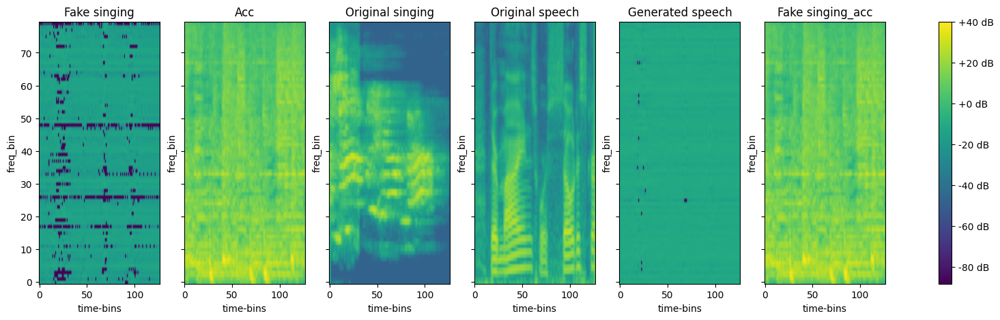

~ Running speech ~
d_loss: 11.120162010192871; built of 'd_loss_whole:10.114940643310547' & 'd_loss_vocal':1.0052214860916138
g_loss: -6.630535125732422; built of 'g_loss_whole:-7.775418758392334' & 'g_loss_vocal:-0.004584442358464003' & 'mae_loss_speech:1.1494681358337402' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.26it/s, loss=0.00503, spectral_convergence=-12.2]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 106.95it/s, loss=0.118, spectral_convergence=-35.8]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 111.39it/s, loss=0.00525, spectral_convergence=-21.3]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 109.10it/s, loss=0.184, spectral_convergence=-26.6]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 107.79it/s, loss=1.54, spectral_convergence=-28.5]


display spectrograms


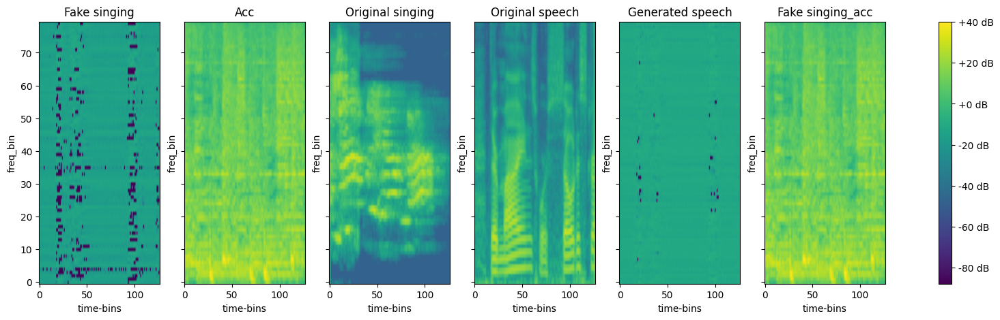

Running batch 1
~ Running singing ~
d_loss: 6.9401984214782715; built of 'd_loss_whole:5.935654640197754' & 'd_loss_vocal':1.004543662071228
g_loss: 26.328575134277344; built of 'g_loss_whole:-4.379132270812988' & 'g_loss_vocal:-0.0040100314654409885' & 'mae_loss_speech:2.7911163330078126' & 'mae_loss_identity:27.92060089111328
~ Running speech ~
d_loss: 6.297819137573242; built of 'd_loss_whole:5.293910980224609' & 'd_loss_vocal':1.0039080381393433
g_loss: -2.115060329437256; built of 'g_loss_whole:-3.842343807220459' & 'g_loss_vocal:-0.0034289932809770107' & 'mae_loss_speech:1.7307125091552735' & 'mae_loss_identity:0.0
Running batch 2
~ Running singing ~
d_loss: 7.0381317138671875; built of 'd_loss_whole:6.034632682800293' & 'd_loss_vocal':1.003498911857605
g_loss: 35.13002014160156; built of 'g_loss_whole:-4.496563911437988' & 'g_loss_vocal:-0.003051066305488348' & 'mae_loss_speech:3.6012344360351562' & 'mae_loss_identity:36.02840042114258
~ Running speech ~
d_loss: 6.46946001052856

100%|██████████| 1000/1000 [00:10<00:00, 95.46it/s, loss=0.00773, spectral_convergence=-27.9]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 101.60it/s, loss=0.254, spectral_convergence=-27.8]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.02it/s, loss=0.00833, spectral_convergence=-26.9]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 92.78it/s, loss=0.365, spectral_convergence=-26.9]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 106.56it/s, loss=1.53, spectral_convergence=-19.7]


display spectrograms


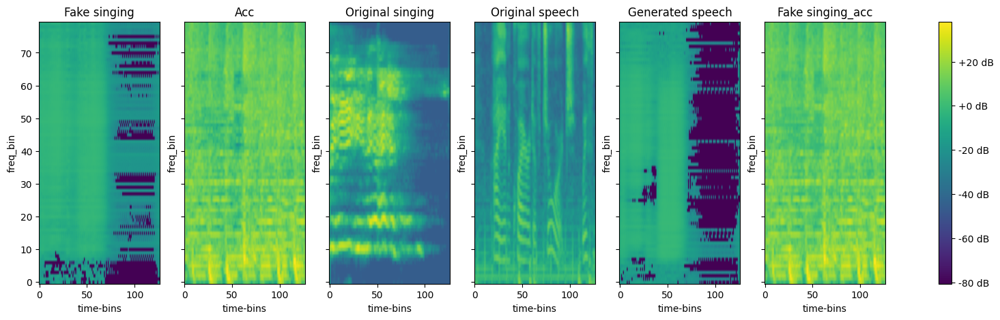

~ Running speech ~
d_loss: 0.9921776652336121; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9921776652336121
g_loss: 2.9550206661224365; built of 'g_loss_whole:1.9623737335205078' & 'g_loss_vocal:0.007897873409092426' & 'mae_loss_speech:0.9847490310668946' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:09<00:00, 106.33it/s, loss=0.00323, spectral_convergence=-11.3]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.66it/s, loss=0.287, spectral_convergence=-26]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 102.77it/s, loss=0.00222, spectral_convergence=-13.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 96.15it/s, loss=0.0121, spectral_convergence=-32.7] 


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 102.78it/s, loss=1.23, spectral_convergence=-22.4]


display spectrograms


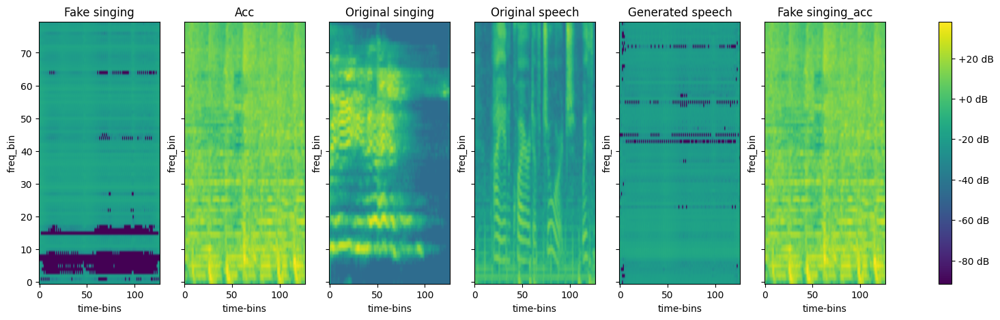

Running batch 101
~ Running singing ~
d_loss: 0.9919611215591431; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9919611215591431
g_loss: 32.69043731689453; built of 'g_loss_whole:1.7474069595336914' & 'g_loss_vocal:0.008114595897495747' & 'mae_loss_speech:2.8123550415039062' & 'mae_loss_identity:28.122562408447266
~ Running speech ~
d_loss: 0.9922221899032593; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9922221899032593
g_loss: 3.1878674030303955; built of 'g_loss_whole:1.7675411701202393' & 'g_loss_vocal:0.007846470922231674' & 'mae_loss_speech:1.4124796867370606' & 'mae_loss_identity:0.0
Running batch 102
~ Running singing ~
d_loss: 5.299423694610596; built of 'd_loss_whole:4.306998252868652' & 'd_loss_vocal':0.9924254417419434
g_loss: 29.455469131469727; built of 'g_loss_whole:-0.0775817260146141' & 'g_loss_vocal:0.007638825569301844' & 'mae_loss_speech:2.6837846755981447' & 'mae_loss_identity:26.84162712097168
~ Running speech ~
d_loss: 2.069451332092285; built of 'd_loss_whole

100%|██████████| 1000/1000 [00:10<00:00, 96.09it/s, loss=0.00851, spectral_convergence=-27.5]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 97.52it/s, loss=0.114, spectral_convergence=-38.2]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 98.31it/s, loss=0.00822, spectral_convergence=-26.8]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 101.75it/s, loss=0.174, spectral_convergence=-32]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 95.45it/s, loss=0.989, spectral_convergence=-36.9]


display spectrograms


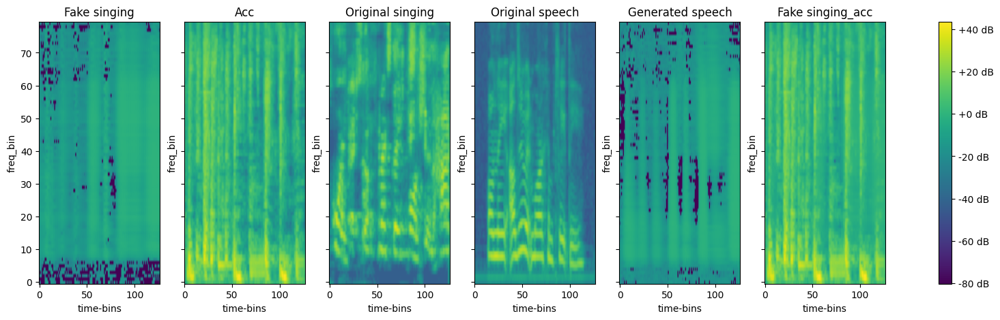

~ Running speech ~
d_loss: 0.9770029783248901; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9770029783248901
g_loss: 3.315528392791748; built of 'g_loss_whole:1.5546728372573853' & 'g_loss_vocal:0.02324680984020233' & 'mae_loss_speech:1.7376087188720704' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.74it/s, loss=0.00792, spectral_convergence=-27]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 103.63it/s, loss=0.12, spectral_convergence=-36.7]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 95.62it/s, loss=0.00734, spectral_convergence=-25.8]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 104.18it/s, loss=0.112, spectral_convergence=-37.5]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 95.49it/s, loss=1.59, spectral_convergence=-28.4] 


display spectrograms


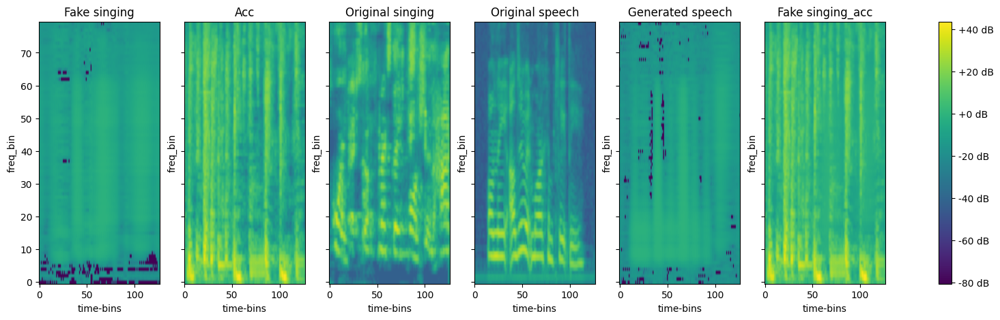

Running batch 201
~ Running singing ~
d_loss: 0.975821316242218; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.975821316242218
g_loss: 27.9378719329834; built of 'g_loss_whole:1.8326114416122437' & 'g_loss_vocal:0.024447521194815636' & 'mae_loss_speech:2.372060775756836' & 'mae_loss_identity:23.708751678466797
~ Running speech ~
d_loss: 0.9761661291122437; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9761661291122437
g_loss: 2.760587215423584; built of 'g_loss_whole:1.831557273864746' & 'g_loss_vocal:0.024091526865959167' & 'mae_loss_speech:0.9049383163452149' & 'mae_loss_identity:0.0
Running batch 202
~ Running singing ~
d_loss: 0.9763214588165283; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9763214588165283
g_loss: 24.99787139892578; built of 'g_loss_whole:2.6261959075927734' & 'g_loss_vocal:0.023925477638840675' & 'mae_loss_speech:2.0314544677734374' & 'mae_loss_identity:20.316295623779297
~ Running speech ~
d_loss: 0.9766579270362854; built of 'd_loss_whole:0.0' & 'd_loss_voc

100%|██████████| 1000/1000 [00:10<00:00, 97.15it/s, loss=0.0131, spectral_convergence=-29.2]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 100.26it/s, loss=0.871, spectral_convergence=-28.8]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 102.27it/s, loss=0.0129, spectral_convergence=-29.1]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 92.88it/s, loss=0.736, spectral_convergence=-30.2] 


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 102.82it/s, loss=0.141, spectral_convergence=-39.1]


display spectrograms


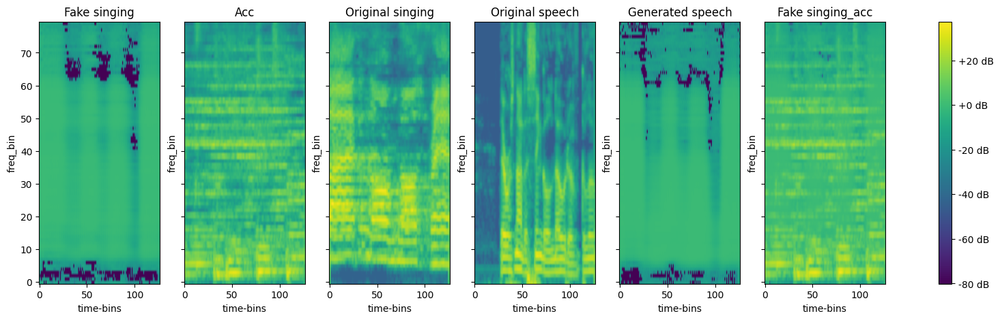

~ Running speech ~
d_loss: 1.304758071899414; built of 'd_loss_whole:0.35461103916168213' & 'd_loss_vocal':0.9501470327377319
g_loss: 3.7150697708129883; built of 'g_loss_whole:0.8830269575119019' & 'g_loss_vocal:0.05022185295820236' & 'mae_loss_speech:2.781820869445801' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:09<00:00, 102.83it/s, loss=0.00814, spectral_convergence=-27.5]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.63it/s, loss=0.891, spectral_convergence=-27.8] 


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 103.70it/s, loss=0.00841, spectral_convergence=-27.8]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 96.97it/s, loss=0.412, spectral_convergence=-27.4]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 100.18it/s, loss=0.222, spectral_convergence=-32.3]


display spectrograms


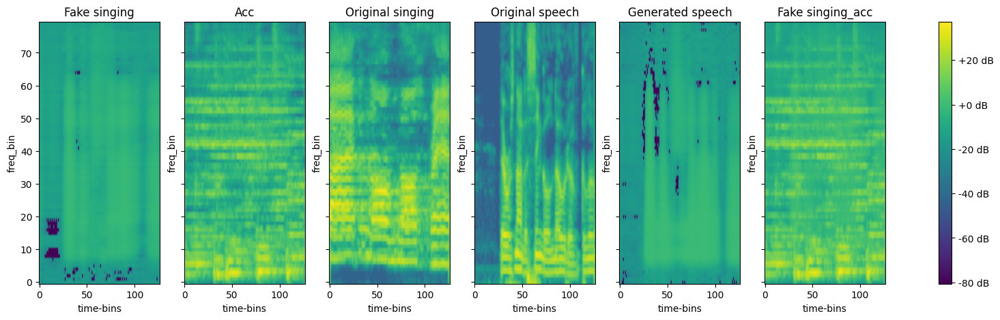

Running batch 301
~ Running singing ~
d_loss: 0.9405511021614075; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9405511021614075
g_loss: 22.735227584838867; built of 'g_loss_whole:1.477504014968872' & 'g_loss_vocal:0.05993705242872238' & 'mae_loss_speech:1.9279289245605469' & 'mae_loss_identity:19.26985740661621
~ Running speech ~
d_loss: 0.943332850933075; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.943332850933075
g_loss: 2.621856212615967; built of 'g_loss_whole:1.5747283697128296' & 'g_loss_vocal:0.05708957463502884' & 'mae_loss_speech:0.9900382995605469' & 'mae_loss_identity:0.0
Running batch 302
~ Running singing ~
d_loss: 1.3068879842758179; built of 'd_loss_whole:0.36806583404541016' & 'd_loss_vocal':0.9388221502304077
g_loss: 28.399660110473633; built of 'g_loss_whole:1.151232123374939' & 'g_loss_vocal:0.061669278889894485' & 'mae_loss_speech:2.4724563598632816' & 'mae_loss_identity:24.71430206298828
~ Running speech ~
d_loss: 0.9384303092956543; built of 'd_loss_whole:0.0

100%|██████████| 1000/1000 [00:10<00:00, 92.07it/s, loss=0.0109, spectral_convergence=-22.9] 


song original singing:


100%|██████████| 1000/1000 [00:12<00:00, 77.92it/s, loss=0.24, spectral_convergence=-34.8]


generated speech:


100%|██████████| 1000/1000 [00:12<00:00, 82.90it/s, loss=0.00877, spectral_convergence=-25.5] 


original speech


100%|██████████| 1000/1000 [00:10<00:00, 97.18it/s, loss=0.349, spectral_convergence=-28.8]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.03it/s, loss=2.73, spectral_convergence=-17.6] 


display spectrograms


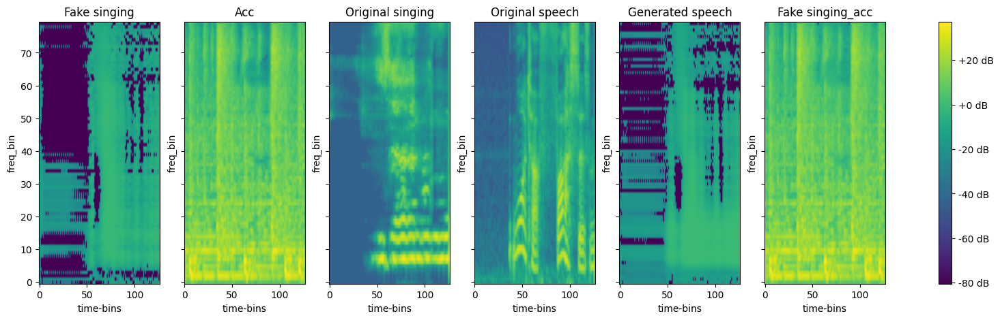

~ Running speech ~
d_loss: 0.9386340379714966; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9386340379714966
g_loss: 4.773553371429443; built of 'g_loss_whole:1.9698400497436523' & 'g_loss_vocal:0.06212298199534416' & 'mae_loss_speech:2.741590118408203' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.74it/s, loss=0.00699, spectral_convergence=-28.6]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 92.77it/s, loss=0.406, spectral_convergence=-22.9] 


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 102.78it/s, loss=0.00637, spectral_convergence=-27.9]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 96.45it/s, loss=0.092, spectral_convergence=-30.9]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.34it/s, loss=2.33, spectral_convergence=-17.5]


display spectrograms


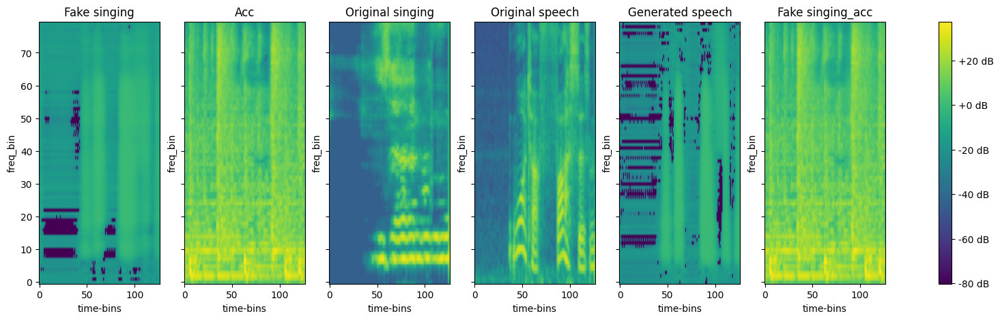

Running batch 401
~ Running singing ~
d_loss: 0.9321171641349792; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9321171641349792
g_loss: 39.120201110839844; built of 'g_loss_whole:2.6431002616882324' & 'g_loss_vocal:0.06878931075334549' & 'mae_loss_speech:3.3119167327880863' & 'mae_loss_identity:33.09639358520508
~ Running speech ~
d_loss: 0.9324090480804443; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9324090480804443
g_loss: 4.326665878295898; built of 'g_loss_whole:2.590714693069458' & 'g_loss_vocal:0.06843634694814682' & 'mae_loss_speech:1.6675146102905274' & 'mae_loss_identity:0.0
Running batch 402
~ Running singing ~
d_loss: 0.9328488707542419; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9328488707542419
g_loss: 32.74013900756836; built of 'g_loss_whole:2.2338144779205322' & 'g_loss_vocal:0.06797119230031967' & 'mae_loss_speech:2.767022132873535' & 'mae_loss_identity:27.67133140563965
~ Running speech ~
d_loss: 0.933333158493042; built of 'd_loss_whole:0.0' & 'd_loss_vocal

100%|██████████| 1000/1000 [00:11<00:00, 90.79it/s, loss=0.01, spectral_convergence=-25.4]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 103.06it/s, loss=0.78, spectral_convergence=-23.7]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 92.13it/s, loss=0.0123, spectral_convergence=-25.3] 


original speech


100%|██████████| 1000/1000 [00:09<00:00, 100.49it/s, loss=1.29, spectral_convergence=-21.1]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 100.21it/s, loss=1.12, spectral_convergence=-18.2]


display spectrograms


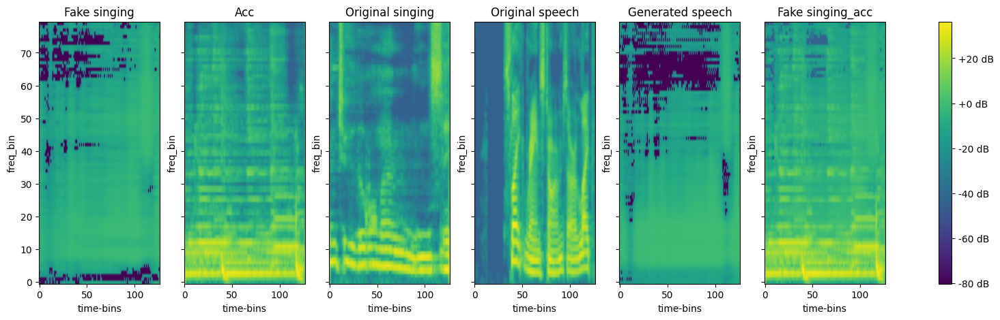

~ Running speech ~
d_loss: 0.8352451920509338; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8352451920509338
g_loss: 4.346974849700928; built of 'g_loss_whole:2.9972496032714844' & 'g_loss_vocal:0.16556492447853088' & 'mae_loss_speech:1.184160327911377' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 92.65it/s, loss=0.012, spectral_convergence=-28.5] 


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 95.85it/s, loss=0.786, spectral_convergence=-23.8]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.28it/s, loss=0.0105, spectral_convergence=-27.5]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 94.76it/s, loss=0.43, spectral_convergence=-23.6]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 102.17it/s, loss=0.822, spectral_convergence=-25.2]


display spectrograms


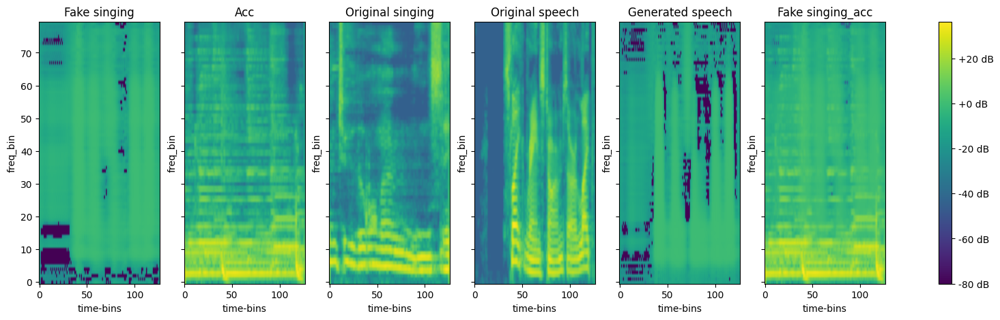

Running batch 501
~ Running singing ~
d_loss: 0.8351939916610718; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8351939916610718
g_loss: 18.650754928588867; built of 'g_loss_whole:1.0993117094039917' & 'g_loss_vocal:0.16557715833187103' & 'mae_loss_speech:1.5792957305908204' & 'mae_loss_identity:15.806570053100586
~ Running speech ~
d_loss: 0.8446630239486694; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8446630239486694
g_loss: 1.9074556827545166; built of 'g_loss_whole:1.0969942808151245' & 'g_loss_vocal:0.15599896013736725' & 'mae_loss_speech:0.6544624328613282' & 'mae_loss_identity:0.0
Running batch 502
~ Running singing ~
d_loss: 0.8392841219902039; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8392841219902039
g_loss: 17.533859252929688; built of 'g_loss_whole:1.8340486288070679' & 'g_loss_vocal:0.1613730639219284' & 'mae_loss_speech:1.4122055053710938' & 'mae_loss_identity:14.126233100891113
~ Running speech ~
d_loss: 0.8536452054977417; built of 'd_loss_whole:0.0' & 'd_loss

100%|██████████| 1000/1000 [00:09<00:00, 101.64it/s, loss=0.0152, spectral_convergence=-29]


song original singing:


100%|██████████| 1000/1000 [00:11<00:00, 88.50it/s, loss=3.06, spectral_convergence=-26]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 95.60it/s, loss=0.0126, spectral_convergence=-30.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 96.87it/s, loss=4.15, spectral_convergence=-20.7]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.24it/s, loss=4.71, spectral_convergence=-16.2]


display spectrograms


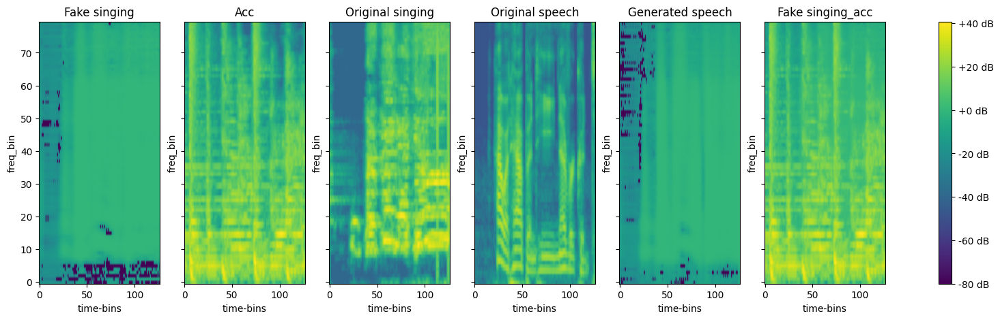

~ Running speech ~
d_loss: 0.8119221329689026; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8119221329689026
g_loss: 3.849179744720459; built of 'g_loss_whole:1.6526062488555908' & 'g_loss_vocal:0.1885371208190918' & 'mae_loss_speech:2.008036231994629' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 92.76it/s, loss=0.00984, spectral_convergence=-29.5]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 101.82it/s, loss=2.8, spectral_convergence=-26.7]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 98.11it/s, loss=0.00926, spectral_convergence=-28.1]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 103.01it/s, loss=0.193, spectral_convergence=-27.7]


fake combine


100%|██████████| 1000/1000 [00:11<00:00, 87.35it/s, loss=5.16, spectral_convergence=-17.3] 


display spectrograms


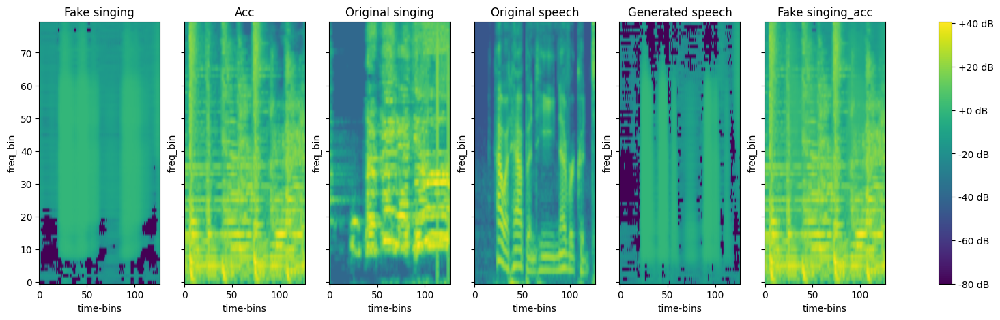

Running batch 601
~ Running singing ~
d_loss: 0.7916948795318604; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7916948795318604
g_loss: 39.150611877441406; built of 'g_loss_whole:3.9593873023986816' & 'g_loss_vocal:0.20886564254760742' & 'mae_loss_speech:3.179672431945801' & 'mae_loss_identity:31.802684783935547
~ Running speech ~
d_loss: 0.8010514378547668; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8010514378547668
g_loss: 5.583279609680176; built of 'g_loss_whole:3.9583003520965576' & 'g_loss_vocal:0.199490025639534' & 'mae_loss_speech:1.4254894256591797' & 'mae_loss_identity:0.0
Running batch 602
~ Running singing ~
d_loss: 0.7898074984550476; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7898074984550476
g_loss: 42.361141204833984; built of 'g_loss_whole:3.7491371631622314' & 'g_loss_vocal:0.2107897251844406' & 'mae_loss_speech:3.4929817199707034' & 'mae_loss_identity:34.908233642578125
~ Running speech ~
d_loss: 0.7998676896095276; built of 'd_loss_whole:0.0' & 'd_loss_voc

100%|██████████| 1000/1000 [00:10<00:00, 98.66it/s, loss=0.0126, spectral_convergence=-27.4]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 94.55it/s, loss=1.21, spectral_convergence=-26.2]


generated speech:


100%|██████████| 1000/1000 [00:11<00:00, 89.83it/s, loss=0.0126, spectral_convergence=-27]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 100.43it/s, loss=1.06, spectral_convergence=-27]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 94.44it/s, loss=0.21, spectral_convergence=-33]


display spectrograms


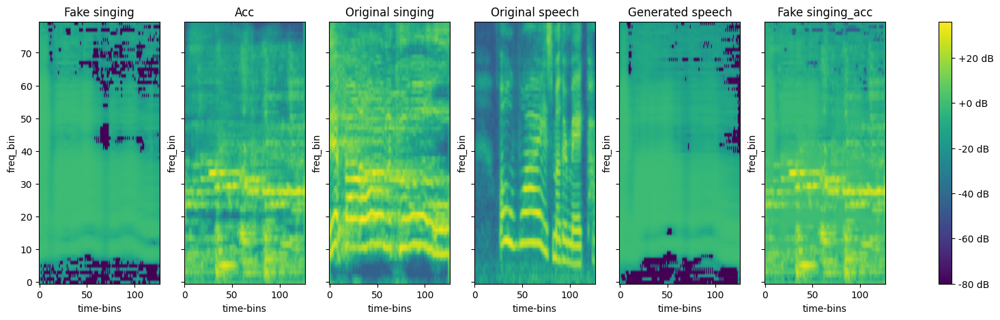

~ Running speech ~
d_loss: 0.8729296326637268; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8729296326637268
g_loss: 2.9499549865722656; built of 'g_loss_whole:1.3690346479415894' & 'g_loss_vocal:0.12759360671043396' & 'mae_loss_speech:1.4533266067504884' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 95.20it/s, loss=0.0116, spectral_convergence=-27.8]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 97.60it/s, loss=1.12, spectral_convergence=-27.1]


generated speech:


100%|██████████| 1000/1000 [00:11<00:00, 89.86it/s, loss=0.00998, spectral_convergence=-27.5]


original speech


100%|██████████| 1000/1000 [00:11<00:00, 85.95it/s, loss=0.262, spectral_convergence=-31.4]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 98.62it/s, loss=0.181, spectral_convergence=-36.2]


display spectrograms


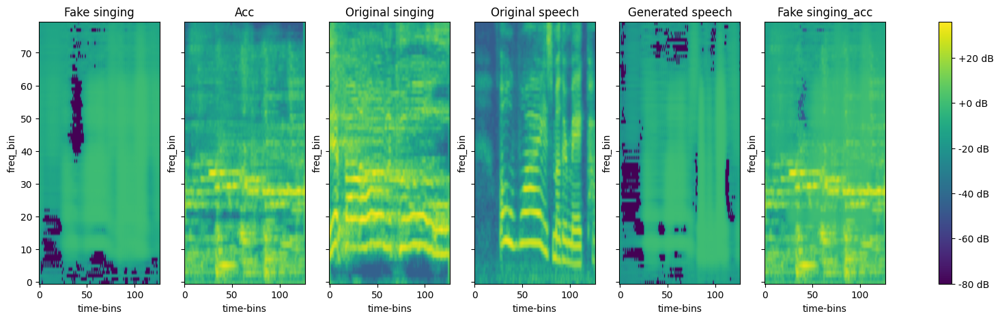

Running batch 701
~ Running singing ~
d_loss: 0.8489071130752563; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8489071130752563
g_loss: 32.20393371582031; built of 'g_loss_whole:2.5024819374084473' & 'g_loss_vocal:0.15176761150360107' & 'mae_loss_speech:2.6875885009765628' & 'mae_loss_identity:26.862096786499023
~ Running speech ~
d_loss: 0.8619132041931152; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8619132041931152
g_loss: 3.5542147159576416; built of 'g_loss_whole:2.5059638023376465' & 'g_loss_vocal:0.13867206871509552' & 'mae_loss_speech:0.9095787048339844' & 'mae_loss_identity:0.0
Running batch 702
~ Running singing ~
d_loss: 2.24308705329895; built of 'd_loss_whole:1.389671802520752' & 'd_loss_vocal':0.8534151911735535
g_loss: 15.801719665527344; built of 'g_loss_whole:2.696528196334839' & 'g_loss_vocal:0.1472342312335968' & 'mae_loss_speech:1.1769561767578125' & 'mae_loss_identity:11.781001091003418
~ Running speech ~
d_loss: 1.8648109436035156; built of 'd_loss_whole:0.99

100%|██████████| 1000/1000 [00:11<00:00, 90.32it/s, loss=0.0133, spectral_convergence=-23.9]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 99.95it/s, loss=0.586, spectral_convergence=-24.7]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 99.07it/s, loss=0.0104, spectral_convergence=-27.3] 


original speech


100%|██████████| 1000/1000 [00:10<00:00, 94.66it/s, loss=0.49, spectral_convergence=-21.3]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 100.87it/s, loss=2.86, spectral_convergence=-15.4]


display spectrograms


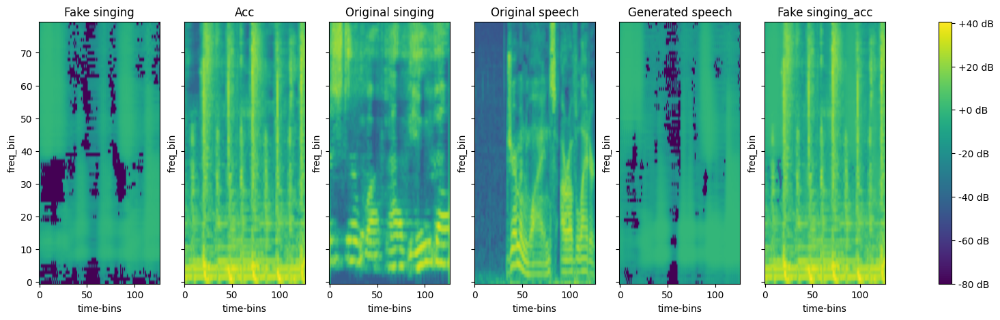

~ Running speech ~
d_loss: 0.7944621443748474; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7944621443748474
g_loss: 2.8688979148864746; built of 'g_loss_whole:1.6206443309783936' & 'g_loss_vocal:0.20590052008628845' & 'mae_loss_speech:1.0423529624938965' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 97.74it/s, loss=0.012, spectral_convergence=-29.4]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.13it/s, loss=0.513, spectral_convergence=-24.1]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.92it/s, loss=0.0106, spectral_convergence=-28.2]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 94.34it/s, loss=0.197, spectral_convergence=-26.5]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 93.44it/s, loss=1.98, spectral_convergence=-25.7]


display spectrograms


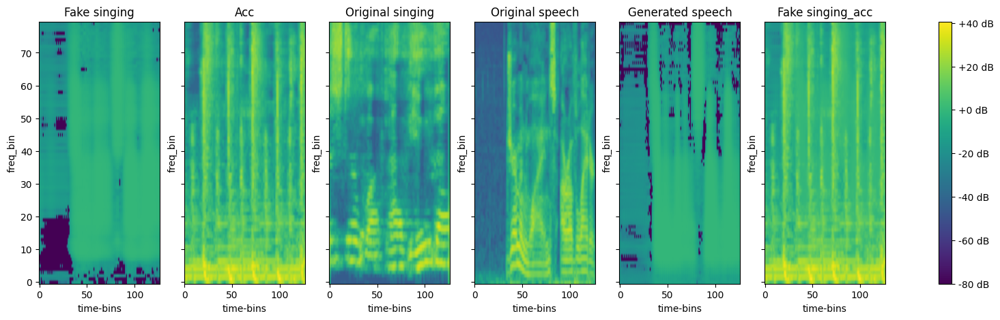

Running batch 801
~ Running singing ~
d_loss: 0.7788070440292358; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7788070440292358
g_loss: 25.16373634338379; built of 'g_loss_whole:2.549283266067505' & 'g_loss_vocal:0.22152800858020782' & 'mae_loss_speech:2.0359851837158205' & 'mae_loss_identity:20.3569393157959
~ Running speech ~
d_loss: 0.7915703654289246; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7915703654289246
g_loss: 3.8877081871032715; built of 'g_loss_whole:2.5466928482055664' & 'g_loss_vocal:0.2086758315563202' & 'mae_loss_speech:1.1323394775390625' & 'mae_loss_identity:0.0
Running batch 802
~ Running singing ~
d_loss: 0.7610624432563782; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7610624432563782
g_loss: 41.68264389038086; built of 'g_loss_whole:3.3309707641601562' & 'g_loss_vocal:0.23922094702720642' & 'mae_loss_speech:3.4661251068115235' & 'mae_loss_identity:34.64632797241211
~ Running speech ~
d_loss: 0.785728931427002; built of 'd_loss_whole:0.0' & 'd_loss_vocal'

100%|██████████| 1000/1000 [00:11<00:00, 87.79it/s, loss=0.00819, spectral_convergence=-29.3]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.03it/s, loss=0.0745, spectral_convergence=-31.7]


generated speech:


100%|██████████| 1000/1000 [00:11<00:00, 90.81it/s, loss=0.00948, spectral_convergence=-28.1]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 98.60it/s, loss=0.0568, spectral_convergence=-36.8]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 99.18it/s, loss=0.783, spectral_convergence=-21.8] 


display spectrograms


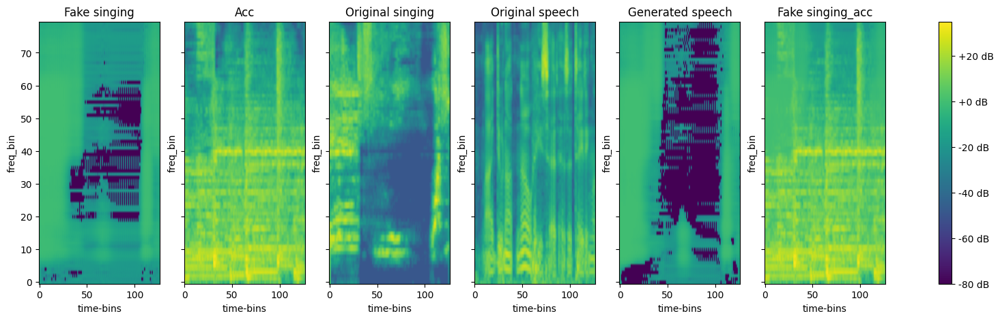

~ Running speech ~
d_loss: 0.76871258020401; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.76871258020401
g_loss: 4.156386375427246; built of 'g_loss_whole:2.9307281970977783' & 'g_loss_vocal:0.23162372410297394' & 'mae_loss_speech:0.994034481048584' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.40it/s, loss=0.00795, spectral_convergence=-25.1]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 97.57it/s, loss=0.124, spectral_convergence=-25.4]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 99.93it/s, loss=0.00684, spectral_convergence=-25.1]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 93.36it/s, loss=0.0461, spectral_convergence=-38]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 104.55it/s, loss=0.674, spectral_convergence=-25.3]


display spectrograms


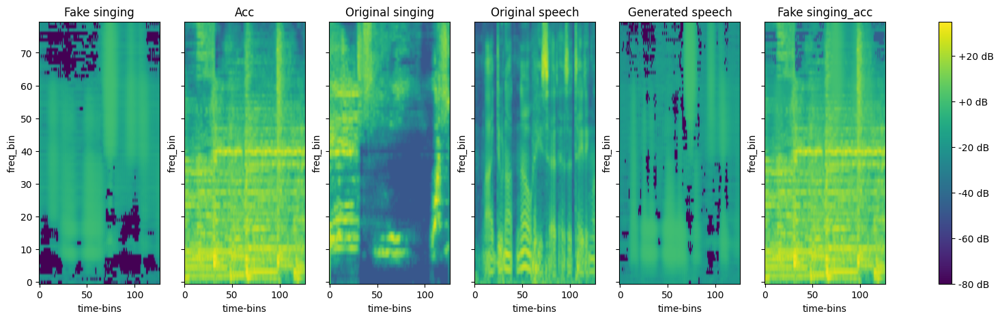

Running batch 901
~ Running singing ~
d_loss: 0.7407812476158142; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7407812476158142
g_loss: 30.423439025878906; built of 'g_loss_whole:2.451385021209717' & 'g_loss_vocal:0.25962260365486145' & 'mae_loss_speech:2.519725799560547' & 'mae_loss_identity:25.192705154418945
~ Running speech ~
d_loss: 0.761008620262146; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.761008620262146
g_loss: 3.9760828018188477; built of 'g_loss_whole:2.4514529705047607' & 'g_loss_vocal:0.2393490970134735' & 'mae_loss_speech:1.2852805137634278' & 'mae_loss_identity:0.0
Running batch 902
~ Running singing ~
d_loss: 0.7706276178359985; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7706276178359985
g_loss: 100.4126205444336; built of 'g_loss_whole:1.9478905200958252' & 'g_loss_vocal:0.22972175478935242' & 'mae_loss_speech:8.929986572265625' & 'mae_loss_identity:89.30502319335938
~ Running speech ~
d_loss: 0.7323223948478699; built of 'd_loss_whole:0.0' & 'd_loss_vocal'

100%|██████████| 1000/1000 [00:10<00:00, 98.07it/s, loss=0.011, spectral_convergence=-29]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 92.40it/s, loss=0.32, spectral_convergence=-33.5]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.38it/s, loss=0.013, spectral_convergence=-27.3]


original speech


100%|██████████| 1000/1000 [00:11<00:00, 90.84it/s, loss=0.316, spectral_convergence=-32.3] 


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.46it/s, loss=1.27, spectral_convergence=-20.7]


display spectrograms


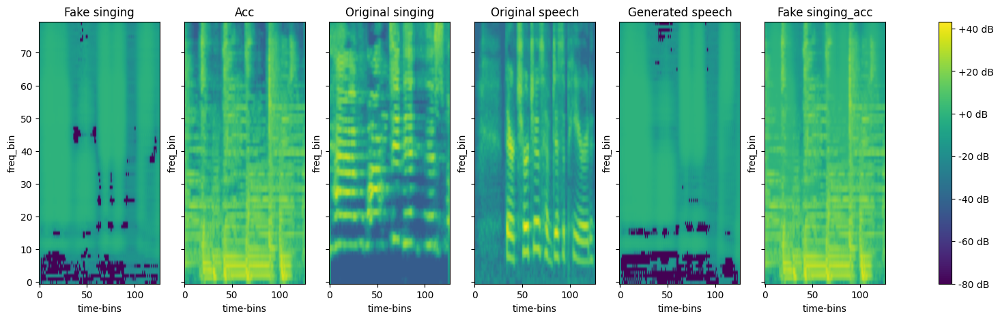

~ Running speech ~
d_loss: 0.7795530557632446; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7795530557632446
g_loss: 3.249527931213379; built of 'g_loss_whole:1.734262228012085' & 'g_loss_vocal:0.2215554267168045' & 'mae_loss_speech:1.2937101364135744' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.85it/s, loss=0.012, spectral_convergence=-26.9] 


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 99.25it/s, loss=0.303, spectral_convergence=-32.1]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 92.59it/s, loss=0.0097, spectral_convergence=-28.6]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 100.25it/s, loss=0.476, spectral_convergence=-29.1]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 91.03it/s, loss=1.3, spectral_convergence=-22.7] 


display spectrograms


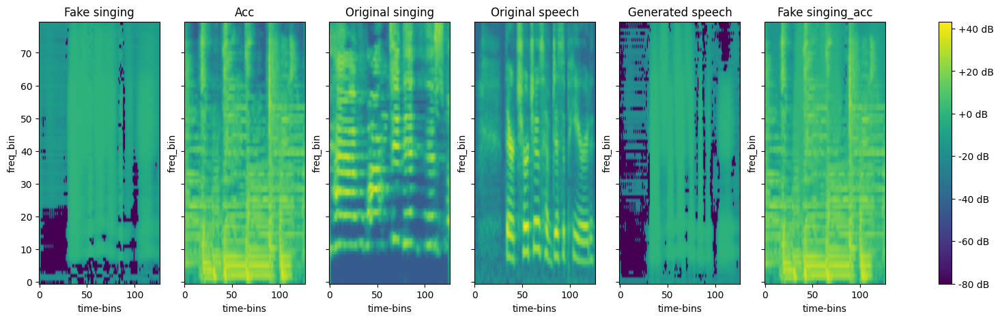

Running batch 1001
~ Running singing ~
d_loss: 0.756718099117279; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.756718099117279
g_loss: 23.517765045166016; built of 'g_loss_whole:1.9881948232650757' & 'g_loss_vocal:0.2446378469467163' & 'mae_loss_speech:1.9355173110961914' & 'mae_loss_identity:19.349414825439453
~ Running speech ~
d_loss: 0.7994046211242676; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7994046211242676
g_loss: 4.550193786621094; built of 'g_loss_whole:1.9914510250091553' & 'g_loss_vocal:0.20156893134117126' & 'mae_loss_speech:2.3571739196777344' & 'mae_loss_identity:0.0
Running batch 1002
~ Running singing ~
d_loss: 0.7601751685142517; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7601751685142517
g_loss: 21.056838989257812; built of 'g_loss_whole:1.752743124961853' & 'g_loss_vocal:0.2410789281129837' & 'mae_loss_speech:1.732762336730957' & 'mae_loss_identity:17.33025550842285
~ Running speech ~
d_loss: 0.7802348136901855; built of 'd_loss_whole:0.0' & 'd_loss_voca

100%|██████████| 1000/1000 [00:10<00:00, 92.07it/s, loss=0.0111, spectral_convergence=-28.6]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 100.64it/s, loss=0.35, spectral_convergence=-26]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 96.17it/s, loss=0.012, spectral_convergence=-28.7]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 99.15it/s, loss=0.246, spectral_convergence=-27.5]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.66it/s, loss=0.976, spectral_convergence=-23.3] 


display spectrograms


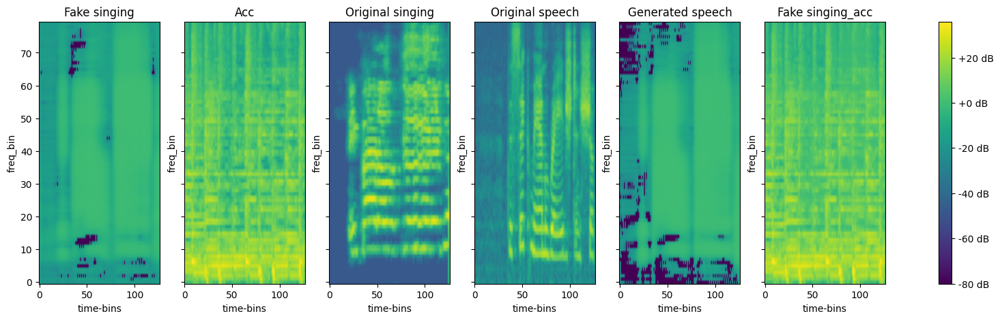

~ Running speech ~
d_loss: 0.6853271126747131; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6853271126747131
g_loss: 7.049221992492676; built of 'g_loss_whole:5.727588653564453' & 'g_loss_vocal:0.3155664801597595' & 'mae_loss_speech:1.0060667991638184' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:09<00:00, 100.63it/s, loss=0.0119, spectral_convergence=-27.2]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.89it/s, loss=0.29, spectral_convergence=-28.5]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 103.68it/s, loss=0.00896, spectral_convergence=-27.6]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 98.14it/s, loss=0.0468, spectral_convergence=-33.5]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 106.07it/s, loss=1.15, spectral_convergence=-22.5]


display spectrograms


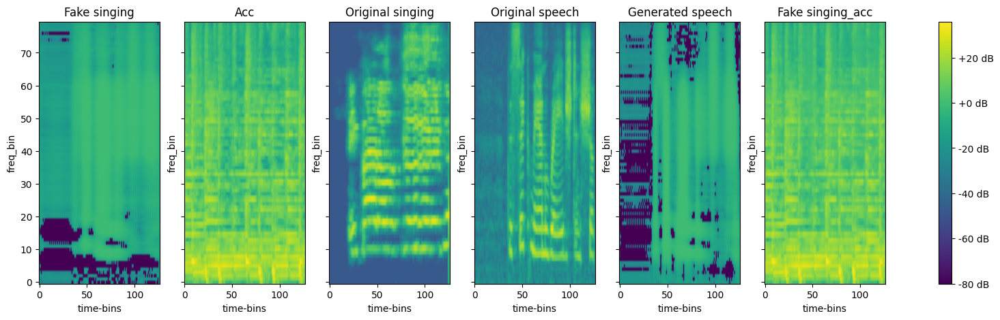

Running batch 1101
~ Running singing ~
d_loss: 0.6641950607299805; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6641950607299805
g_loss: 33.98697280883789; built of 'g_loss_whole:2.590999126434326' & 'g_loss_vocal:0.3367384076118469' & 'mae_loss_speech:2.8235698699951173' & 'mae_loss_identity:28.23566436767578
~ Running speech ~
d_loss: 0.67595374584198; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.67595374584198
g_loss: 4.032489776611328; built of 'g_loss_whole:2.591426372528076' & 'g_loss_vocal:0.32487449049949646' & 'mae_loss_speech:1.1161888122558594' & 'mae_loss_identity:0.0
Running batch 1102
~ Running singing ~
d_loss: 0.6902211308479309; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6902211308479309
g_loss: 30.637264251708984; built of 'g_loss_whole:3.026463508605957' & 'g_loss_vocal:0.31049320101737976' & 'mae_loss_speech:2.4811218261718753' & 'mae_loss_identity:24.819185256958008
~ Running speech ~
d_loss: 0.682249128818512; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0

100%|██████████| 1000/1000 [00:09<00:00, 102.52it/s, loss=0.0108, spectral_convergence=-27.9]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 94.01it/s, loss=0.427, spectral_convergence=-21.1]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 98.26it/s, loss=0.00912, spectral_convergence=-28.7]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 103.53it/s, loss=0.368, spectral_convergence=-29.6]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 94.28it/s, loss=2.66, spectral_convergence=-22.1]


display spectrograms


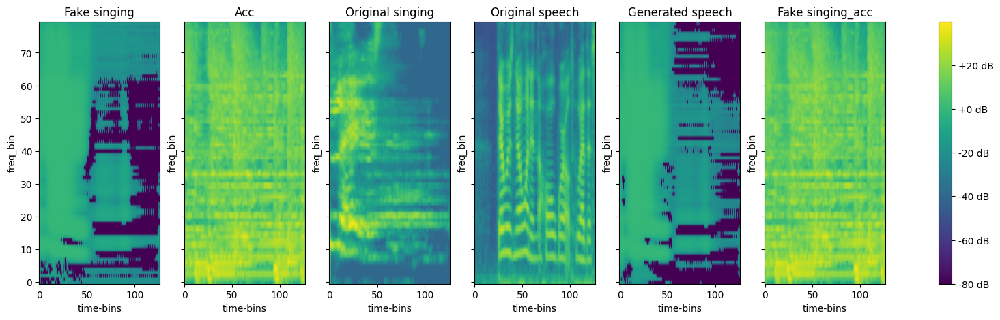

~ Running speech ~
d_loss: 0.712005078792572; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.712005078792572
g_loss: 3.129862070083618; built of 'g_loss_whole:1.9328895807266235' & 'g_loss_vocal:0.28826719522476196' & 'mae_loss_speech:0.9087051391601563' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.16it/s, loss=0.0139, spectral_convergence=-25.1] 


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 105.06it/s, loss=0.341, spectral_convergence=-27.8]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 95.68it/s, loss=0.0101, spectral_convergence=-27.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 99.77it/s, loss=0.0943, spectral_convergence=-30.6]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.48it/s, loss=2.72, spectral_convergence=-19.9]


display spectrograms


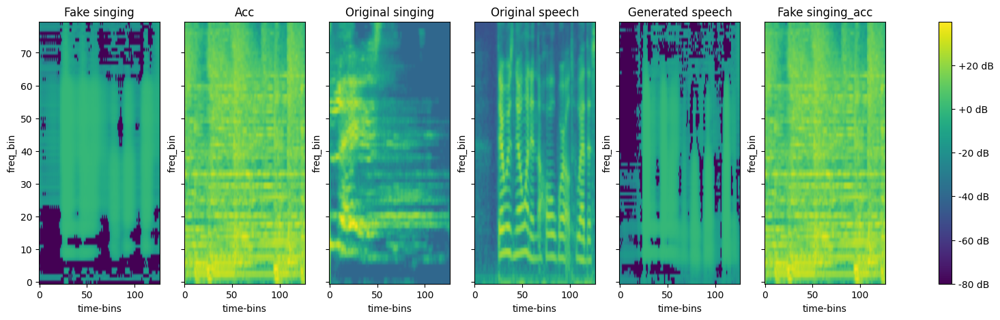

Running batch 1201
~ Running singing ~
d_loss: 0.6816084980964661; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6816084980964661
g_loss: 29.21144676208496; built of 'g_loss_whole:2.5703063011169434' & 'g_loss_vocal:0.3187011182308197' & 'mae_loss_speech:2.3933208465576175' & 'mae_loss_identity:23.929119110107422
~ Running speech ~
d_loss: 0.7228397130966187; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7228397130966187
g_loss: 4.007314682006836; built of 'g_loss_whole:2.586561679840088' & 'g_loss_vocal:0.2774079442024231' & 'mae_loss_speech:1.1433452606201173' & 'mae_loss_identity:0.0
Running batch 1202
~ Running singing ~
d_loss: 0.6895886659622192; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6895886659622192
g_loss: 29.90643310546875; built of 'g_loss_whole:1.5569071769714355' & 'g_loss_vocal:0.3106918931007385' & 'mae_loss_speech:2.548513221740723' & 'mae_loss_identity:25.49032211303711
~ Running speech ~
d_loss: 0.719093918800354; built of 'd_loss_whole:0.0' & 'd_loss_vocal'

100%|██████████| 1000/1000 [00:09<00:00, 106.17it/s, loss=0.0138, spectral_convergence=-27.9]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 95.43it/s, loss=0.399, spectral_convergence=-34.3]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 102.03it/s, loss=0.0113, spectral_convergence=-28.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 99.87it/s, loss=0.62, spectral_convergence=-29.7]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 101.33it/s, loss=0.655, spectral_convergence=-22.7]


display spectrograms


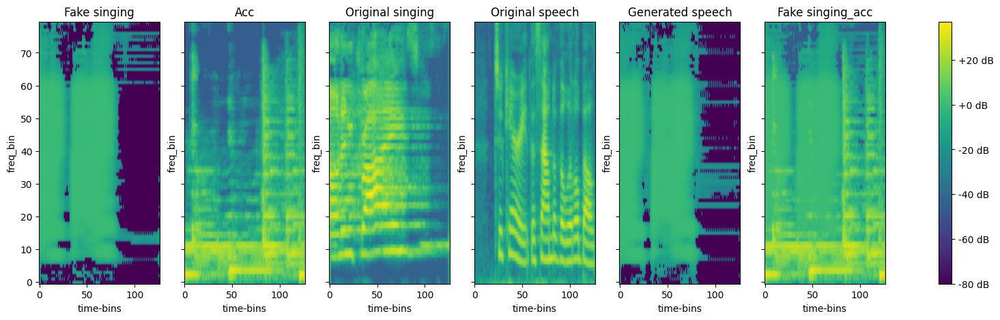

~ Running speech ~
d_loss: 0.6744672060012817; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6744672060012817
g_loss: 2.507732391357422; built of 'g_loss_whole:1.260408639907837' & 'g_loss_vocal:0.3261380195617676' & 'mae_loss_speech:0.92118558883667' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 99.38it/s, loss=0.0139, spectral_convergence=-29.1]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 94.08it/s, loss=0.493, spectral_convergence=-32]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 93.52it/s, loss=0.0123, spectral_convergence=-27.8]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 103.99it/s, loss=0.274, spectral_convergence=-23.5]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 99.45it/s, loss=0.92, spectral_convergence=-18.5]


display spectrograms


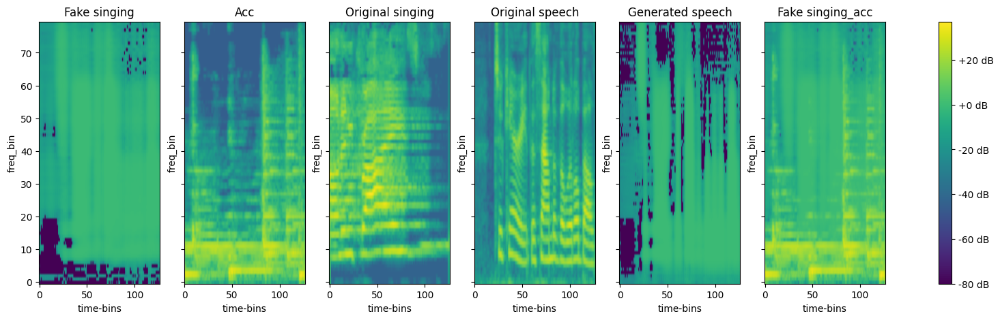

Running batch 1301
~ Running singing ~
d_loss: 0.6752097010612488; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6752097010612488
g_loss: 37.66691589355469; built of 'g_loss_whole:4.83469295501709' & 'g_loss_vocal:0.3254576325416565' & 'mae_loss_speech:2.9548305511474613' & 'mae_loss_identity:29.55193328857422
~ Running speech ~
d_loss: 0.6785271167755127; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6785271167755127
g_loss: 6.200201988220215; built of 'g_loss_whole:4.835263729095459' & 'g_loss_vocal:0.32218021154403687' & 'mae_loss_speech:1.0427578926086427' & 'mae_loss_identity:0.0
Running batch 1302
~ Running singing ~
d_loss: 0.6467149257659912; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6467149257659912
g_loss: 23.542522430419922; built of 'g_loss_whole:2.2248969078063965' & 'g_loss_vocal:0.3541796803474426' & 'mae_loss_speech:1.9048992156982423' & 'mae_loss_identity:19.05854606628418
~ Running speech ~
d_loss: 0.7159684896469116; built of 'd_loss_whole:0.0' & 'd_loss_vocal

100%|██████████| 1000/1000 [00:10<00:00, 94.56it/s, loss=0.0126, spectral_convergence=-27.4]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 105.41it/s, loss=0.245, spectral_convergence=-31.9]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.08it/s, loss=0.0125, spectral_convergence=-27.6]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 102.78it/s, loss=0.217, spectral_convergence=-38.3]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 96.78it/s, loss=2.16, spectral_convergence=-19.5]


display spectrograms


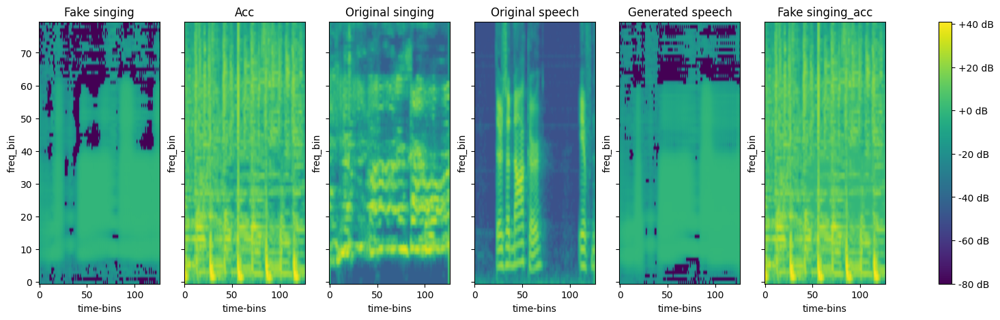

~ Running speech ~
d_loss: 0.7156773805618286; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7156773805618286
g_loss: 3.933560848236084; built of 'g_loss_whole:2.6228747367858887' & 'g_loss_vocal:0.2848649322986603' & 'mae_loss_speech:1.0258212089538574' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:09<00:00, 100.67it/s, loss=0.0103, spectral_convergence=-29.1]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 93.98it/s, loss=0.286, spectral_convergence=-33.6]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 103.42it/s, loss=0.00857, spectral_convergence=-29.2]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 99.42it/s, loss=0.0666, spectral_convergence=-29.1] 


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 104.48it/s, loss=2.56, spectral_convergence=-19.1]


display spectrograms


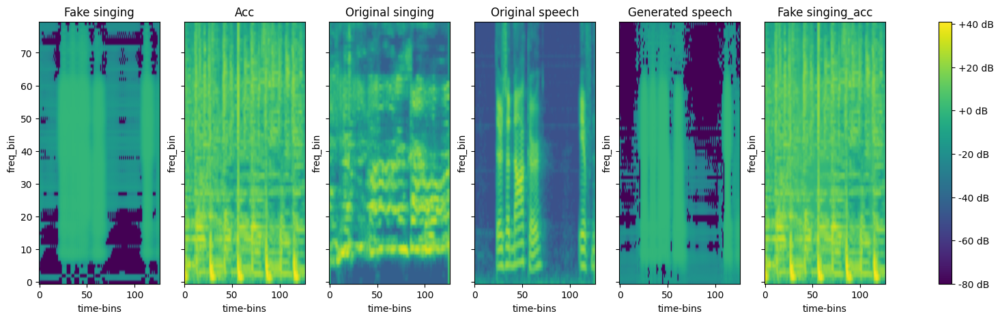

Running batch 1401
~ Running singing ~
d_loss: 0.6945159435272217; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6945159435272217
g_loss: 30.278034210205078; built of 'g_loss_whole:2.3415348529815674' & 'g_loss_vocal:0.30605506896972656' & 'mae_loss_speech:2.511650276184082' & 'mae_loss_identity:25.118793487548828
~ Running speech ~
d_loss: 0.7140517234802246; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7140517234802246
g_loss: 4.910968780517578; built of 'g_loss_whole:2.3428847789764404' & 'g_loss_vocal:0.2864554822444916' & 'mae_loss_speech:2.2816286087036133' & 'mae_loss_identity:0.0
Running batch 1402
~ Running singing ~
d_loss: 0.7063197493553162; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7063197493553162
g_loss: 31.001968383789062; built of 'g_loss_whole:3.1398580074310303' & 'g_loss_vocal:0.2943111062049866' & 'mae_loss_speech:2.5056213378906254' & 'mae_loss_identity:25.062177658081055
~ Running speech ~
d_loss: 0.7225863933563232; built of 'd_loss_whole:0.0' & 'd_loss_

100%|██████████| 1000/1000 [00:10<00:00, 98.35it/s, loss=0.0124, spectral_convergence=-28.5] 


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 105.46it/s, loss=0.233, spectral_convergence=-34.4]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 100.29it/s, loss=0.0122, spectral_convergence=-28.4]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 102.94it/s, loss=0.326, spectral_convergence=-32.6]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 97.53it/s, loss=0.459, spectral_convergence=-24.9] 


display spectrograms


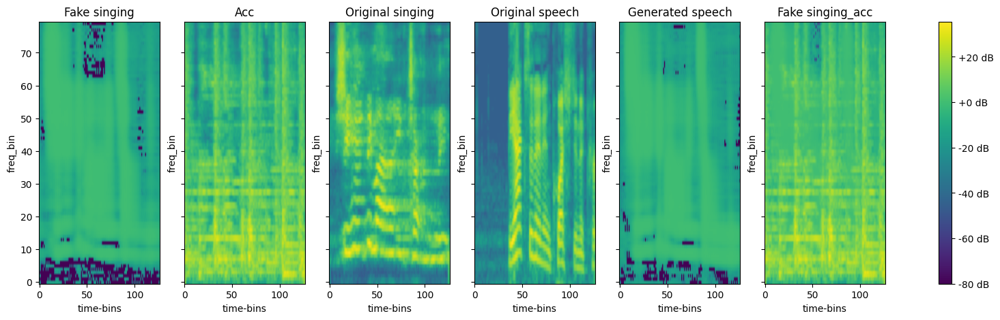

~ Running speech ~
d_loss: 0.8649906516075134; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8649906516075134
g_loss: 4.722950458526611; built of 'g_loss_whole:2.9223685264587402' & 'g_loss_vocal:0.13762016594409943' & 'mae_loss_speech:1.662961769104004' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.04it/s, loss=0.011, spectral_convergence=-30] 


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 96.77it/s, loss=0.403, spectral_convergence=-29.7]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 107.14it/s, loss=0.00881, spectral_convergence=-29]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 95.00it/s, loss=0.326, spectral_convergence=-26.8]


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 106.30it/s, loss=0.446, spectral_convergence=-24.2]


display spectrograms


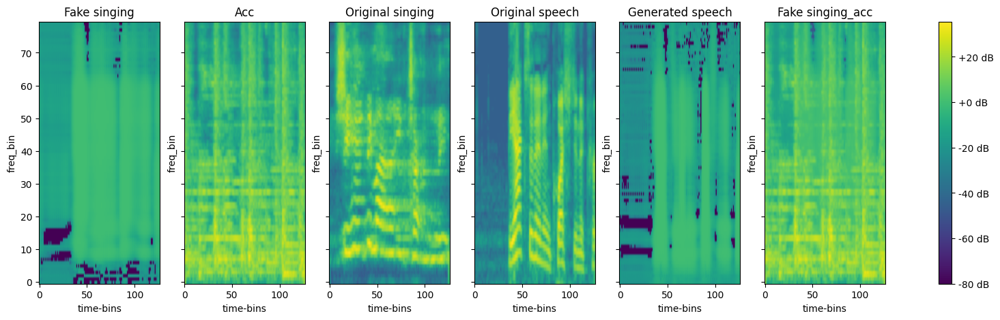

Running batch 1501
~ Running singing ~
d_loss: 0.8412758111953735; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8412758111953735
g_loss: 30.022174835205078; built of 'g_loss_whole:2.983360767364502' & 'g_loss_vocal:0.16193243861198425' & 'mae_loss_speech:2.4432443618774418' & 'mae_loss_identity:24.433637619018555
~ Running speech ~
d_loss: 0.8543264269828796; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.8543264269828796
g_loss: 4.323896884918213; built of 'g_loss_whole:2.9830164909362793' & 'g_loss_vocal:0.14815236628055573' & 'mae_loss_speech:1.1927281379699708' & 'mae_loss_identity:0.0
Running batch 1502
~ Running singing ~
d_loss: 0.83354252576828; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.83354252576828
g_loss: 36.03683090209961; built of 'g_loss_whole:2.2409825325012207' & 'g_loss_vocal:0.16974559426307678' & 'mae_loss_speech:3.056765937805176' & 'mae_loss_identity:30.569337844848633
~ Running speech ~
d_loss: 0.8377097845077515; built of 'd_loss_whole:0.0' & 'd_loss_voca

100%|██████████| 1000/1000 [00:10<00:00, 97.11it/s, loss=0.0106, spectral_convergence=-27.4]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 100.91it/s, loss=0.311, spectral_convergence=-32.9]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 99.00it/s, loss=0.0109, spectral_convergence=-26.5]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 105.49it/s, loss=0.363, spectral_convergence=-29]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 94.95it/s, loss=0.435, spectral_convergence=-26.2]


display spectrograms


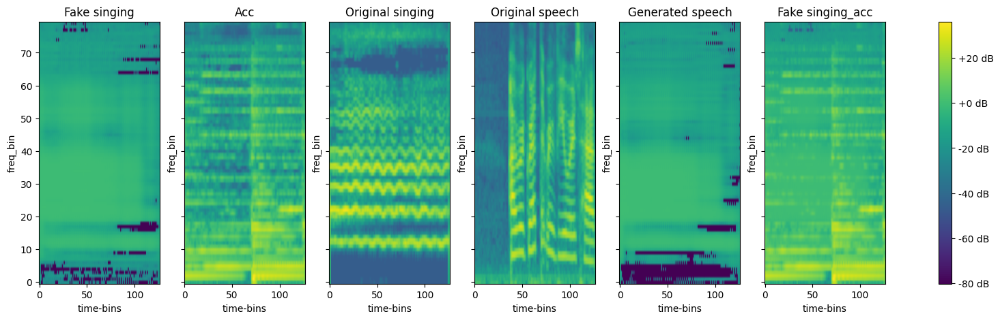

~ Running speech ~
d_loss: 0.6763502359390259; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6763502359390259
g_loss: 5.6933770179748535; built of 'g_loss_whole:4.362697124481201' & 'g_loss_vocal:0.32442978024482727' & 'mae_loss_speech:1.00625' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 95.02it/s, loss=0.0116, spectral_convergence=-29.4] 


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 98.69it/s, loss=0.305, spectral_convergence=-34.4]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 100.37it/s, loss=0.00962, spectral_convergence=-28.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 92.94it/s, loss=0.152, spectral_convergence=-28] 


fake combine


100%|██████████| 1000/1000 [00:09<00:00, 101.93it/s, loss=0.287, spectral_convergence=-31.3]


display spectrograms


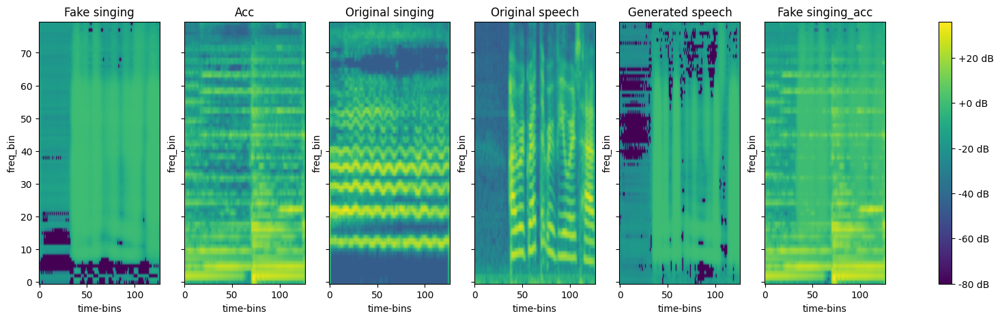

Running batch 1601
~ Running singing ~
d_loss: 0.6202725768089294; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6202725768089294
g_loss: 20.47701644897461; built of 'g_loss_whole:1.8053487539291382' & 'g_loss_vocal:0.38064044713974' & 'mae_loss_speech:1.6635982513427736' & 'mae_loss_identity:16.62742805480957
~ Running speech ~
d_loss: 0.6608444452285767; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6608444452285767
g_loss: 3.2097878456115723; built of 'g_loss_whole:1.8096824884414673' & 'g_loss_vocal:0.3398732542991638' & 'mae_loss_speech:1.0602320671081544' & 'mae_loss_identity:0.0
Running batch 1602
~ Running singing ~
d_loss: 0.6217141151428223; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6217141151428223
g_loss: 30.111011505126953; built of 'g_loss_whole:3.7083842754364014' & 'g_loss_vocal:0.37902963161468506' & 'mae_loss_speech:2.366061019897461' & 'mae_loss_identity:23.65753746032715
~ Running speech ~
d_loss: 0.6681537628173828; built of 'd_loss_whole:0.0' & 'd_loss_voca

100%|██████████| 1000/1000 [00:09<00:00, 104.69it/s, loss=0.00737, spectral_convergence=-25.8]


song original singing:


100%|██████████| 1000/1000 [00:11<00:00, 89.97it/s, loss=0.0446, spectral_convergence=-34.3]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 96.86it/s, loss=0.00779, spectral_convergence=-24.3]


original speech


100%|██████████| 1000/1000 [00:10<00:00, 99.15it/s, loss=0.0452, spectral_convergence=-31.6]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 94.46it/s, loss=0.0107, spectral_convergence=-25]


display spectrograms


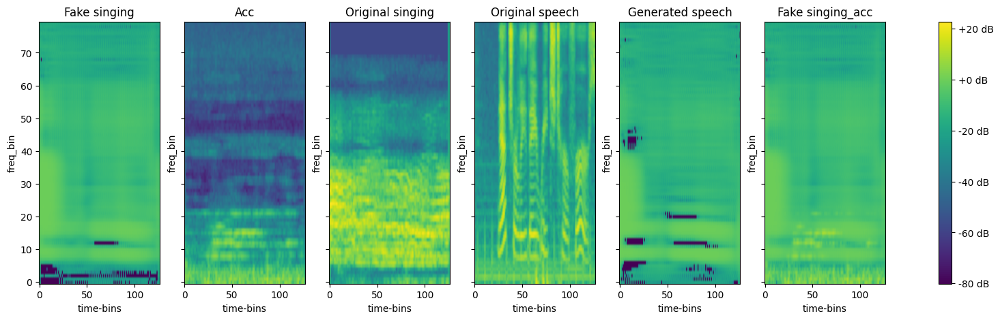

~ Running speech ~
d_loss: 0.6899368762969971; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6899368762969971
g_loss: 4.459591388702393; built of 'g_loss_whole:2.7508108615875244' & 'g_loss_vocal:0.31056517362594604' & 'mae_loss_speech:1.3982152938842773' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 95.88it/s, loss=0.00708, spectral_convergence=-27.4] 


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 102.71it/s, loss=0.0436, spectral_convergence=-32.6]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 95.85it/s, loss=0.00626, spectral_convergence=-25.6]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 103.44it/s, loss=0.0181, spectral_convergence=-31.8]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 98.20it/s, loss=0.00955, spectral_convergence=-26.9]


display spectrograms


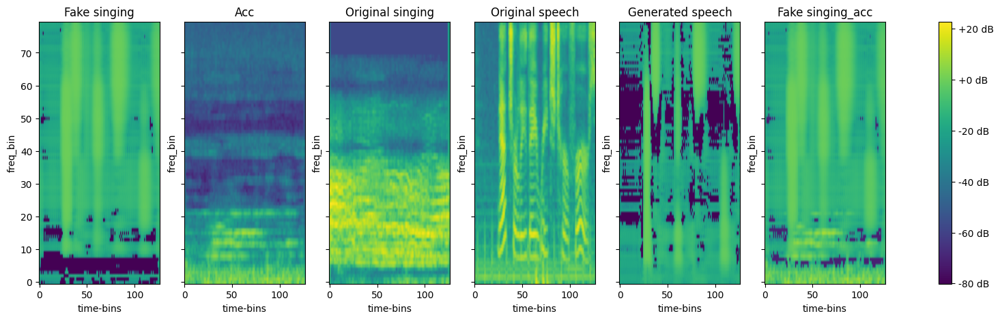

Running batch 1701
~ Running singing ~
d_loss: 0.6760780811309814; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6760780811309814
g_loss: 21.412412643432617; built of 'g_loss_whole:3.0948376655578613' & 'g_loss_vocal:0.32442063093185425' & 'mae_loss_speech:1.635076713562012' & 'mae_loss_identity:16.358078002929688
~ Running speech ~
d_loss: 0.7136112451553345; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.7136112451553345
g_loss: 4.724709987640381; built of 'g_loss_whole:3.1039085388183594' & 'g_loss_vocal:0.28677234053611755' & 'mae_loss_speech:1.3340292930603028' & 'mae_loss_identity:0.0
Running batch 1702
~ Running singing ~
d_loss: 0.6685269474983215; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.6685269474983215
g_loss: 32.01934051513672; built of 'g_loss_whole:3.8683369159698486' & 'g_loss_vocal:0.3319445550441742' & 'mae_loss_speech:2.529794692993164' & 'mae_loss_identity:25.289264678955078
~ Running speech ~
d_loss: 0.6853252053260803; built of 'd_loss_whole:0.0' & 'd_loss_v

100%|██████████| 1000/1000 [00:10<00:00, 93.03it/s, loss=0.00675, spectral_convergence=-25.4]


song original singing:


 34%|███▍      | 340/1000 [00:03<00:06, 105.88it/s, loss=0.0324, spectral_convergence=-32.3]

In [ ]:
opt_gen, opt_disc = optimizers
for epoch in range(epochs):
    # Iterate over your dataset in batches
    batch_number = 0
    try:
      for batch in dl:
        print(f"Running batch {batch_number}")
        mel_accs, mel_vocs, mel_origs, mel_speeches = batch
        # mel_accs = mel_accs.to('cuda')
        # mel_vocs = mel_vocs.to('cuda')
        # mel_origs = mel_origs.to('cuda')
        # mel_speeches = mel_speeches.to('cuda')

        for voices in [{'type': 'singing', 'mels': mel_vocs}, {'type': 'speech', 'mels': mel_speeches}]:
          print(f"~ Running {voices['type']} ~")
          mel_voices = voices['mels']
          # Run Generators
          fake_vocs = gen_speech2sing(mel_voices, mel_accs)
          voc_to_speech = gen_sing2speech(fake_vocs)
          fake_combine = combine_mel_spectrograms(fake_vocs, mel_accs)

          # Run Discriminators
          whole_real_output = discrim_whole(mel_origs)
          whole_fake_output = discrim_whole(fake_combine.detach())
          vocal_real_output = discrim_vocal(mel_vocs)
          vocal_fake_output = discrim_vocal(fake_vocs.detach())

          # Get average powers:
          fake_vocs_power = torch.mean(fake_vocs.detach().pow(2), dim=(1, 2, 3))
          real_vocs_power = torch.mean(mel_vocs.detach().pow(2), dim=(1, 2, 3))
          # Train discriminators
          opt_disc.zero_grad()
          d_loss_whole = d_loss_r(whole_real_output) + d_loss_f(whole_fake_output)
          d_loss_vocal = d_loss_r(vocal_real_output) + d_loss_f(vocal_fake_output)
          d_loss = d_loss_whole + d_loss_vocal
          d_loss.backward()
          opt_disc.step()

          #Train generators
          opt_gen.zero_grad()
          whole_fake_output = discrim_whole(fake_combine.detach())
          vocal_fake_output = discrim_vocal(fake_vocs.detach())
          g_loss_whole = g_loss_f(whole_fake_output)
          g_loss_vocal = g_loss_f(vocal_fake_output)
          mae_loss_speech = mae(voc_to_speech, mel_voices)
          mae_loss_identity = mae(fake_vocs, mel_vocs) if voices['type'] == 'singing' else torch.tensor(0.0)
          g_loss = g_loss_whole + g_loss_vocal + 0.1 * mae_loss_speech + 1.0 * mae_loss_identity
          g_loss.backward()
          opt_gen.step()
          print(f"d_loss: {d_loss.item()}; built of 'd_loss_whole:{d_loss_whole.item()}' & 'd_loss_vocal':{d_loss_vocal.item()}")
          print(f"g_loss: {g_loss.item()}; built of 'g_loss_whole:{g_loss_whole.item()}' & 'g_loss_vocal:{g_loss_vocal.item()}' & 'mae_loss_speech:{mae_loss_speech.item() * 0.1}' & 'mae_loss_identity:{mae_loss_identity.item() * 1.0}")

          if batch_number % 100 == 0:
            try:
              print("generated singing:")
              reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
              print("song original singing:")
              reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
              print("generated speech:")
              reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
              print("original speech")
              reconstructed_audio_orig = GRAD(mel_voices[0].detach(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
              print("fake combine")
              reconstructed_audio_acc = GRAD(fake_combine[0].detach(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
              print("display spectrograms")
              fig, axs = plt.subplots(1, 6, figsize=(20, 5), sharey=True)  # 1 row, 4 columns
              # Calculate overall min and max values for consistent color scale
              all_spectrograms = [fake_vocs[0].detach().numpy().squeeze(),
                                  mel_accs[0].detach().numpy().squeeze(),
                                  mel_vocs[0].detach().numpy().squeeze(),
                                  mel_speeches[0].detach().numpy().squeeze()]
              vmin = np.min([np.min(librosa.power_to_db(spec)) for spec in all_spectrograms])
              vmax = np.max([np.max(librosa.power_to_db(spec)) for spec in all_spectrograms])

              # Plot spectrograms
              im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title=f'Fake singing', ax=axs[0], vmin=vmin, vmax=vmax)
              im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1], vmin=vmin, vmax=vmax)
              im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title=f'Original singing', ax=axs[2], vmin=vmin, vmax=vmax)
              im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech', ax=axs[3], vmin=vmin, vmax=vmax)
              im5 = display_spectrogram(voc_to_speech[0].detach().numpy().squeeze(), title='Generated speech', ax=axs[4], vmin=vmin, vmax=vmax)
              im4 = display_spectrogram(fake_combine[0].detach().numpy().squeeze(), title='Fake singing_acc', ax=axs[5], vmin=vmin, vmax=vmax)

              # Add a single colorbar
              fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

              plt.show()
              if voices['type'] == 'speech':
                save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)

            except Exception as e:
                print(f"Error Saving: {e}")
        batch_number += 1

    except Exception as e:
        print(f"Error during training: {e}")

    # print(f"Models saved for epoch {epoch + 1} in {save_path}")

In [ ]:
print("generated singing:")
reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
print("song original singing:")
reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
print("generated speech:")
reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
print("original speech")
reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
print("fake combine")
reconstructed_audio_acc = GRAD(fake_combine[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
print("display spectrograms")
fig, axs = plt.subplots(1, 6, figsize=(20, 5), sharey=True)  # 1 row, 4 columns
# Calculate overall min and max values for consistent color scale
all_spectrograms = [fake_vocs[0].detach().numpy().squeeze(),
                    mel_accs[0].detach().numpy().squeeze(),
                    mel_vocs[0].detach().numpy().squeeze(),
                    mel_speeches[0].detach().numpy().squeeze()]
vmin = np.min([np.min(librosa.power_to_db(spec)) for spec in all_spectrograms])
vmax = np.max([np.max(librosa.power_to_db(spec)) for spec in all_spectrograms])

# Plot spectrograms
im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title=f'Fake singing', ax=axs[0], vmin=vmin, vmax=vmax)
im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1], vmin=vmin, vmax=vmax)
im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title=f'Original singing', ax=axs[2], vmin=vmin, vmax=vmax)
im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech', ax=axs[3], vmin=vmin, vmax=vmax)
im5 = display_spectrogram(voc_to_speech[0].detach().numpy().squeeze(), title='Generated speech', ax=axs[4], vmin=vmin, vmax=vmax)
im4 = display_spectrogram(fake_combine[0].detach().numpy().squeeze(), title='Fake singing_acc', ax=axs[5], vmin=vmin, vmax=vmax)

# Add a single colorbar
fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

plt.show()

In [ ]:
import matplotlib.pyplot as plt
print("generated singing:")
# reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# display fake_vocs[0] spectrogram image

# plt.imshow(fake_vocs[0].detach().numpy().squeeze(), aspect='auto', origin='lower', cmap='viridis')
# plt.colorbar(format='%+2.0f dB')
# plt.title('Mel Spectrogram')
# plt.xlabel('Time')
# plt.ylabel('Frequency')
# Assuming fake_vocs, mel_accs, mel_vocs, mel_speeches are defined
fig, axs = plt.subplots(1, 4, figsize=(20, 5), sharey=True)  # 1 row, 4 columns

# Plot spectrograms
im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title='Fake singing spectrogram', ax=axs[0])
im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1])
im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title='Original singing spectrogram', ax=axs[2])
im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech spectrogram', ax=axs[3])

# Add a single colorbar
fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

plt.show()


# print("song original singing:")
# reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
# print("generated speech:")
# reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
# print("original speech")
# reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
# print("original accompinemant")
# reconstructed_audio_acc = GRAD(mel_accs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
# save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)